In [3]:
#hide
! [ -e /content ] && pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 11.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 70.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 474.6/474.6 kB 31.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 68.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 37.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 20.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 57.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 12.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [4]:
#hide
from fastbook import *
from fastai.vision.widgets import *

#Preparação do dataset

Definição de categorias

In [5]:
bear_types = 'grizzly','black','teddy'
path = Path('bears')

Download e direcionamento de imagens para os diretórios corretos

In [6]:
if not path.exists():
    path.mkdir()

for o in bear_types:
  if not (path/o).exists():
    dest = (path/o)
    dest.mkdir(exist_ok=True)
    results = search_images_ddg(f'{o} bear')
    download_images(dest, urls=results)

Conferindo as imagens

In [7]:
fns = get_image_files(path)
fns

(#563) [Path('bears/black/60725340-9c6c-4fdd-886f-212b9440836c.JPG'),Path('bears/black/9320f39a-9724-428d-84dd-900a0b9abebc.jpg'),Path('bears/black/8974a796-d1c2-447a-b360-1a7906181bf6.jpg'),Path('bears/black/c071a31f-be19-48c1-b699-e5fef3a8808c.jpg'),Path('bears/black/ba16565b-2765-4c27-bfe6-a067b5486c76.jpg'),Path('bears/black/c16314f3-e488-4bcd-ad56-e5aae608abf4.png'),Path('bears/black/57170f52-833a-4edb-acf7-11464d8c3115.jpg'),Path('bears/black/cddb306b-d246-4867-963e-b460068bd4fe.jpg'),Path('bears/black/8903a5fe-1290-42e0-8bc4-a0d76acdee84.jpg'),Path('bears/black/e1155be0-730f-4e44-9ca6-00cf00b93fdc.jpg')...]

Procura por imagens corrompidas

In [8]:
failed = verify_images(fns)
failed

(#29) [Path('bears/black/674f2a23-958f-4e33-9724-6760d45f794d.jpg'),Path('bears/black/feb110be-2dd7-42bb-8bc7-eb7655f48240.jpg'),Path('bears/black/a501f8e1-abe6-44e0-9626-7892e9e80941.jpg'),Path('bears/black/26d9a5e9-b59b-4fe7-8db6-ebc26ea2e349.jpg'),Path('bears/black/045a7559-a53f-42ed-a1bb-74d2dd69478b.jpg'),Path('bears/black/5aedcd0d-7aca-445b-845b-4a87ee937e4f.jpg'),Path('bears/black/958b3576-c03d-4d52-8fa0-57be83ba05ec.jpg'),Path('bears/grizzly/323c461d-7e97-4dc6-8cba-866c91811456.jpg'),Path('bears/grizzly/eadf6e56-a7f8-41fa-9a67-e26fb37f47c5.jpg'),Path('bears/grizzly/aee5d1d6-9a26-4dbb-ba60-e1f771d9eda7.jpeg')...]

Exclui as imagens corrompidas

In [9]:
failed.map(Path.unlink);

#Data loaders

In [10]:
bears = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))

In [11]:
dls = bears.dataloaders(path)

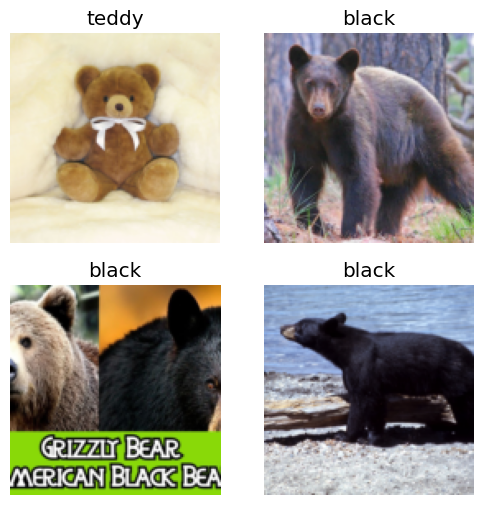

In [14]:
dls.valid.show_batch(max_n=4, nrows=2)

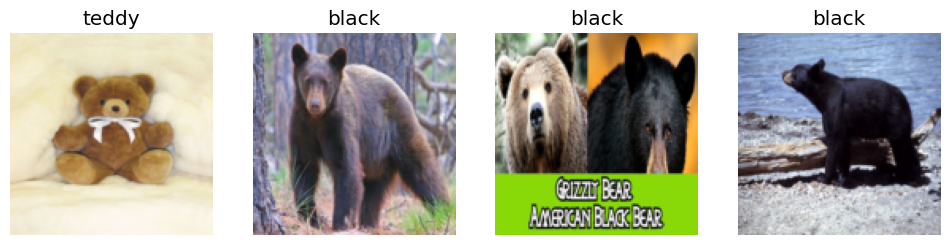

In [15]:
bears = bears.new(item_tfms=Resize(128, ResizeMethod.Squish))
dls = bears.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

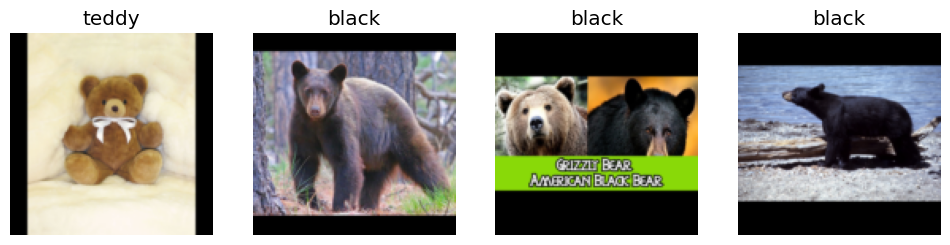

In [16]:
bears = bears.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros'))
dls = bears.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

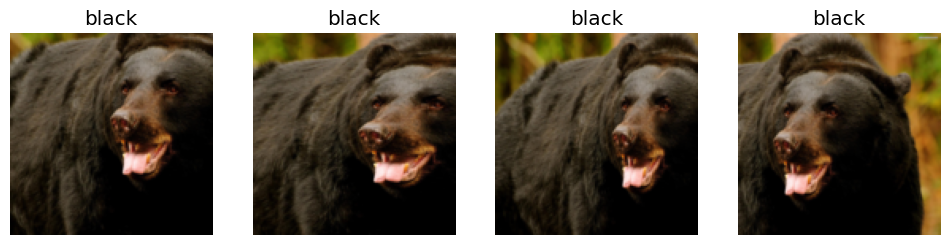

In [17]:
bears = bears.new(item_tfms=RandomResizedCrop(128, min_scale=0.3))
dls = bears.dataloaders(path)
dls.train.show_batch(max_n=4, nrows=1, unique=True)

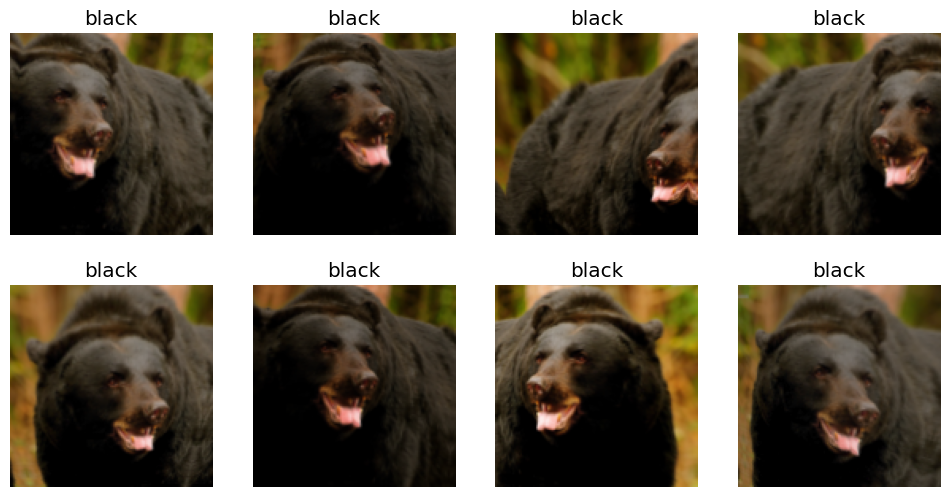

In [18]:
bears = bears.new(item_tfms=Resize(128), batch_tfms=aug_transforms(mult=2))
dls = bears.dataloaders(path)
dls.train.show_batch(max_n=8, nrows=2, unique=True)

# Treinando o modelo

In [19]:
bears = bears.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = bears.dataloaders(path)

In [20]:
learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 106MB/s]


epoch,train_loss,valid_loss,error_rate,time
0,1.698778,0.161582,0.066038,02:01


epoch,train_loss,valid_loss,error_rate,time
0,0.309842,0.226714,0.066038,02:40
1,0.223691,0.224152,0.066038,02:44
2,0.186668,0.188638,0.066038,02:40
3,0.146440,0.166730,0.066038,02:42


Matriz de confusão

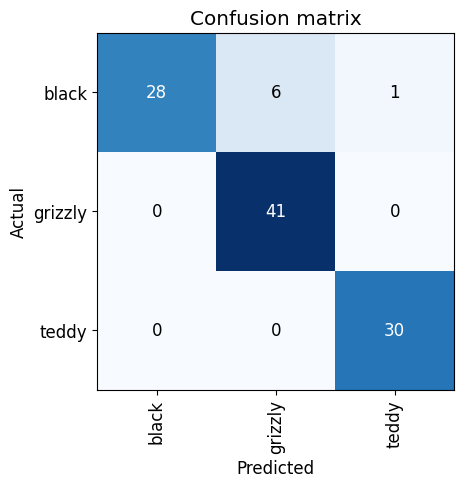

In [21]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

As seguintes células contém o script de limpeza do dataset

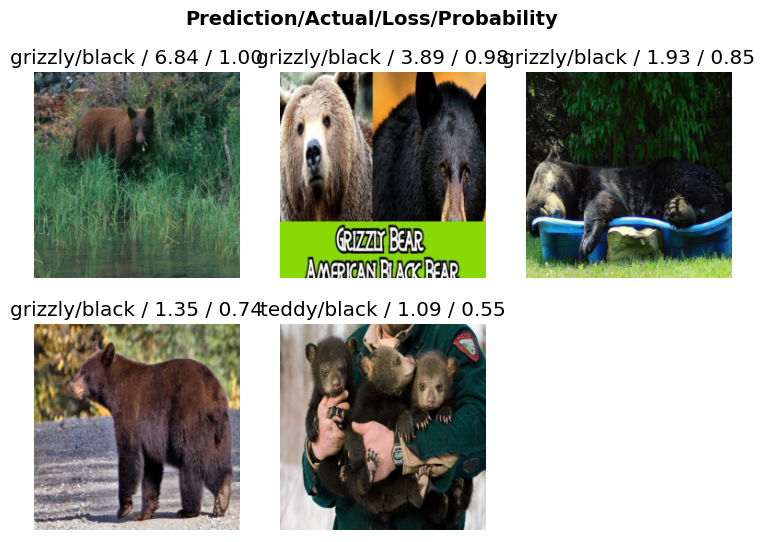

In [23]:
interp.plot_top_losses(5, nrows=2)

In [25]:
#hide_output
cleaner = ImageClassifierCleaner(learn)
cleaner

In [26]:
#hide
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

Exporta o modelo

In [ ]:
learn.export()